# Memory Chips + Words with L1 regularization

En esta notebook haremos un intento de ver palabras que efectúen algún tipo de activación sobre grupos de neuronas

Usaremos como base este paper

["Understanding hidden memories of recurrent neural networks"](https://arxiv.org/abs/1710.10777)

In [1]:
%load_ext autoreload
%autoreload 2
import pandas as pd
import csv
import numpy as np
import tensorflow as tf
import random
import torch

torch.manual_seed(2019)
np.random.seed(2019)
tf.random.set_random_seed(2019)
random.seed(2019)

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

df_dev = pd.read_table("../../../data/es/dev_es.tsv", index_col="id", quoting=csv.QUOTE_NONE)
df_train = pd.read_table("../../../data/es/train_es.tsv", index_col="id", quoting=csv.QUOTE_NONE)
df_test = pd.read_table("../../../data/es/reference_es.tsv", header=None, 
                        names=["text", "HS", "TR", "AG"], quoting=csv.QUOTE_NONE)


text_train, y_train = df_train["text"], df_train["HS"]
text_dev, y_dev = df_dev["text"], df_dev["HS"]
text_test, y_test = df_test["text"], df_test["HS"]

print("Instancias de entrenamiento: {}".format(len(df_train)))
print("Instancias de desarrollo: {}".format(len(df_dev)))
print("Instancias de test: {}".format(len(df_test)))


Instancias de entrenamiento: 4500
Instancias de desarrollo: 500
Instancias de test: 1600


Cargamos datos dev con anotaciones propias

In [2]:
df_dev = pd.read_csv("dev_with_annotations.es.csv", index_col="id")

df_dev = df_dev[df_dev["text"].notnull()]


Cargamos modelos de fasttext y ELMo

In [3]:
%%capture
from elmoformanylangs import Embedder
import fastText
import os


fasttext_model = fastText.load_model(os.path.expanduser("../../../WordVectors/UBA_w3_300.bin"))
elmo_embedder = Embedder("../../../models/elmo/es/")

## GRU + Global Average Pooling

We use a model with a BiLSTM + an average pooling (this is controlled by the `pooling` argument to the ElmoModel)

In [24]:
from hate.nn import ElmoModel
from keras.optimizers import Adam
from keras.layers import LSTM, GRU, CuDNNLSTM, CuDNNGRU
max_length = 40

def MyRecClass(*args, **kwargs):
    kwargs.update({
        'activation': 'sigmoid'
    })
    
    return GRU(*args, **kwargs)

model = ElmoModel(
    max_length, fasttext_model=fasttext_model,
    elmo_embedder=elmo_embedder,
    recursive_class=MyRecClass,
    rnn_units=250, dropout=0.0,
    l1_regularization=0.002,
    pooling='avg',
    tokenize_args = {
        "preserve_case": False,
        "deaccent": False,
        "reduce_len": True,
        "strip_handles": True,
        "alpha_only": False,
        "stem": False
    }
)

#model.load_weights("../../../models/lstm_elmo.h5")
print(model.summary())

Using L1 regularization
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Elmo (InputLayer)               (None, 40, 1024)     0                                            
__________________________________________________________________________________________________
Fasttext (InputLayer)           (None, 40, 300)      0                                            
__________________________________________________________________________________________________
concatenate_2 (Concatenate)     (None, 40, 1324)     0           Elmo[0][0]                       
                                                                 Fasttext[0][0]                   
__________________________________________________________________________________________________
gru_3 (GRU)                     (None, 40, 250)      1181250     concatenate_2[0][0] 

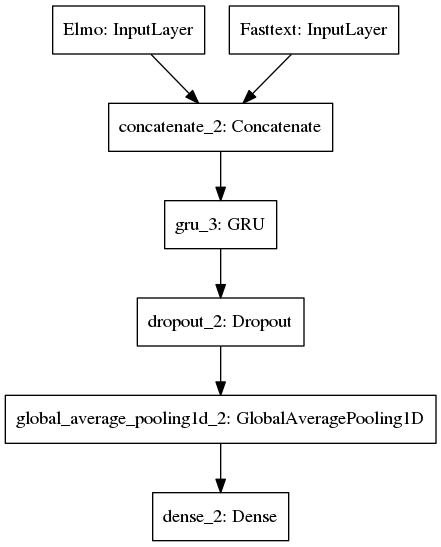

In [25]:
from keras.utils import plot_model
from IPython.display import Image
plot_model(model, to_file='model.png')


Image(filename='model.png') 

In [26]:

optimizer_args = {
    "lr": 0.001,
    "decay": 0.01,
}

model.compile(loss='binary_crossentropy', 
              optimizer=Adam(**optimizer_args), 
              metrics=['accuracy'])

¿Cómo anda el tokenizador?

In [27]:
from keras.callbacks import ModelCheckpoint, EarlyStopping

checkpointer = ModelCheckpoint('/tmp/lstm_model.h5', save_best_only=True, monitor='val_acc', verbose=1)
early_stopper = EarlyStopping(monitor='val_loss', patience=5)


model.fit(text_train, y_train, 
          callbacks=[checkpointer, early_stopper],
          validation_data=(text_dev, y_dev), epochs=100, batch_size=32)


Train on 4500 samples, validate on 500 samples
Epoch 1/100
4500/4500 [==============================] - 8s 2ms/step - loss: 1.1183 - acc: 0.6802 - val_loss: 0.7222 - val_acc: 0.7540

Epoch 00001: val_acc improved from -inf to 0.75400, saving model to /tmp/lstm_model.h5
Epoch 2/100
4500/4500 [==============================] - 7s 2ms/step - loss: 0.6661 - acc: 0.7660 - val_loss: 0.6168 - val_acc: 0.7900

Epoch 00002: val_acc improved from 0.75400 to 0.79000, saving model to /tmp/lstm_model.h5
Epoch 3/100
4500/4500 [==============================] - 7s 2ms/step - loss: 0.5813 - acc: 0.7924 - val_loss: 0.5798 - val_acc: 0.7960

Epoch 00003: val_acc improved from 0.79000 to 0.79600, saving model to /tmp/lstm_model.h5
Epoch 4/100
4500/4500 [==============================] - 7s 2ms/step - loss: 0.5436 - acc: 0.8007 - val_loss: 0.5649 - val_acc: 0.8040

Epoch 00004: val_acc improved from 0.79600 to 0.80400, saving model to /tmp/lstm_model.h5
Epoch 5/100
4500/4500 [=============================

In [28]:
from hate.utils import print_evaluation
print("{} -- \n\n".format(model.display_name))
print("Evaluación sobre dev")

model.load_weights(checkpointer.filepath)

print_evaluation(model, text_dev, y_dev)
print("\nEvaluación sobre test")

print_evaluation(model, text_test, y_test)

GRU with avg pooling consuming ELMo + FastText -- 


Evaluación sobre dev
500/500 [==============================] - 0s 628us/step
Loss           : 0.5014
Accuracy       : 0.8260
Precision(1)   : 0.8063
Precision(1)   : 0.8453
Precision(avg) : 0.8258

Recall(1)      : 0.8063
Recall(0)      : 0.8453
Recall(avg)    : 0.8258

F1(1)          : 0.8063
F1(0)          : 0.8453
F1(avg)        : 0.8258

Evaluación sobre test
1600/1600 [==============================] - 1s 646us/step
Loss           : 0.5915
Accuracy       : 0.7481
Precision(1)   : 0.6807
Precision(1)   : 0.8020
Precision(avg) : 0.7414

Recall(1)      : 0.7333
Recall(0)      : 0.7585
Recall(avg)    : 0.7459

F1(1)          : 0.7061
F1(0)          : 0.7797
F1(avg)        : 0.7429


## Error Analysis

Vamos a ver los tweets con mayores errores

In [29]:
df_dev["proba"] = model.predict(text_dev)
df_dev["PROFANITY"] = 0


true_positives = df_dev[(df_dev["HS"] == 1) & (df_dev["proba"] >= 0.5)].copy()
true_negatives = df_dev[(df_dev["HS"] == 0) & (df_dev["proba"] < 0.5)].copy()

false_positives = df_dev[(df_dev["HS"] == 0) & (df_dev["proba"] > 0.5)].copy()
false_positives.sort_values("proba", ascending=False, inplace=True)


false_negatives = df_dev[(df_dev["HS"] == 1) & (df_dev["proba"] < 0.5)].copy()
false_negatives.sort_values("proba", ascending=True, inplace=True)

conf_matrix = pd.DataFrame([
    {"real":"hs=1", "pred_true": len(true_positives), "pred_false": len(false_negatives)},
    {"real":"hs=0", "pred_true": len(false_positives), "pred_false": len(true_negatives)}
])



conf_matrix.set_index("real", inplace=True)

print("Falsos negativos: {}".format(len(false_negatives)))
print("Falsos positivos: {}".format(len(false_positives)))

conf_matrix[["pred_true", "pred_false"]]

Falsos negativos: 43
Falsos positivos: 44


,pred_true,pred_false
real,,
hs=1,179,43
hs=0,44,234


## Activations

Cortamos las otras capas, y vemos qué está saliendo de la capa recurrente. Para eso, armamos un modelo intermedio

In [30]:
from keras.models import Model
    

interm_model = Model(inputs=model.inputs, outputs=[model.recursive_layer])

¿Cómo afecta cada una de las palabras a las distintas neuronas?

Para calcular eso, vamos a estimar para cada palabra $x$ la respuesta promedio de la capa recurrente

\begin{align}
s(x) &= E(\Delta h^{(t)}|x) \\
s(x) &\sim \frac{1}{T_x} \sum\limits_{x^{(t)} = x} \Delta h^{(t)}
\end{align}

donde $T_x$ es la cantidad de palabras en todas las secuencias iguales a x

In [31]:
tweets = [
    "me cago en tu puta madre",
    "tu madre es, bla bla bla bla, una puta, me cago",
    "GOOOL puta madre!",
    "puta madre, me cago!",
    "eres casi como una rata"
]

for tw, proba in zip(tweets, model.predict(tweets).squeeze()):
    print("{:.4f} --> {}".format(proba, tw))

0.0399 --> me cago en tu puta madre
0.8578 --> tu madre es, bla bla bla bla, una puta, me cago
0.3243 --> GOOOL puta madre!
0.0709 --> puta madre, me cago!
0.8333 --> eres casi como una rata


In [32]:
%%time
import unidecode

def get_interm_outputs(texts):
    """
    Returns intermediate outputs of trained model
    
    Arguments:
    ---------
    
    texts: list of strs
        Texts to be processed by the model
        
    Returns
    -------
    
    (tokens, outputs)
    """
    
    all_tokens = []
    for text in texts:
        all_tokens.append(model._preprocess_tweet(text))


    text_elmo, text_emb = model.preprocess_transform(texts)

    rnn_outputs = interm_model.predict([text_elmo, text_emb]).squeeze()
    # Obtengo longitud de tokens

    last_idxs = [next(j for j in range(len(tokenized_text), -1, -1) if tokenized_text[j-1] != '') 
                for tokenized_text in all_tokens]

    tokens = [["<START>"] + tokenized_text[:last_idx] for tokenized_text, last_idx in zip(all_tokens, last_idxs)]

    outputs = [np.vstack([np.zeros((1, rnn_output.shape[1])), rnn_output[:last_idx, :]]) 
               for rnn_output, last_idx in zip(rnn_outputs, last_idxs)]
    
    return tokens, outputs

texts = [unidecode.unidecode(tweet) for tweet in text_train]
tokens, outputs = get_interm_outputs(texts)
labels = y_train

CPU times: user 27.7 s, sys: 2.23 s, total: 30 s
Wall time: 27.3 s


Vamos a probar qué nos da cada palabra

Para eso, vamos a primero sacarle tildes y otros caracteres unicode para normalizar un poco

In [33]:
import unidecode

unidecode.unidecode("te re cabió 😊😊😊 #hashtag")

'te re cabio  #hashtag'

In [34]:
from collections import defaultdict
from tqdm import tqdm_notebook
import tqdm

deltas = defaultdict(list)
count = defaultdict(int)
hateful_count = defaultdict(int)

for toks, output, is_hate in tqdm_notebook(list(zip(tokens, outputs, labels)), desc="Calculando outputs"):
    tweet_deltas = np.diff(output, axis=0)
    
    for tok, delta in zip(toks[1:], tweet_deltas):
        deltas[tok].append(delta)

    for tok in set(toks[1:]):
        count[tok] += 1
        if is_hate:
            hateful_count[tok] += 1

Tenemos en:
- `raw_outputs` las salidas de cada token
- `count` cantidad de tweets en los que aparece el token
- `hateful_count` cantidad de tweets con hate speech en los que aparece el token
- `tweet_deltas` todos los deltas que generó cada token

In [35]:
hateful_score = {tok: hateful_count[tok]/count[tok] for tok in count}
hateful_score = pd.Series(hateful_score)

In [36]:
avgs = {}

for tok in deltas:
    avgs[tok] = np.average(deltas[tok], axis=0)
    
avgs = pd.DataFrame(avgs).T
counts = pd.Series(count)

avgs.sort_index(inplace=True)

avgs.shape

(13665, 250)

In [37]:
lens = np.array([len(l) for l in avgs.index])

print("Palabras con dos o menos caracteres: ", (lens <= 2).sum())
print("Hashtags: ", len([l for l in avgs.index if l[0] == '#']))
print("Not alpha: ", len([l for l in avgs.index if not l.isalpha()]))

def plural(tok):
    return tok[-1] == 's' and tok[:-1] in avgs.index

print("Plurales: ", len([l for l in avgs.index if plural(l)]))


indexes = np.array([l for l in avgs.index if len(l) >= 4 and l[0] != "#" and l.isalpha() and counts[l] >= 3])

print("Nos quedamos con {} palabras (antes había {})".format(len(indexes), len(avgs)))


Z = avgs.loc[indexes].values

Z_norm = (Z - Z.mean(axis=0)) / Z.std()

Palabras con dos o menos caracteres:  302
Hashtags:  635
Not alpha:  1011
Plurales:  1293
Nos quedamos con 2560 palabras (antes había 13665)


Ahora, veamos las activaciones. Les resto la media ya que hay algunas neuronas que se mantienen muy activadas todo el tiempo

In [38]:
%matplotlib inline
import plotly.graph_objects as go


fig_heatmap = go.Figure(
    data=go.Heatmap(
        z=Z_norm,
        y=indexes,
        #colorscale='RdBu', reversescale=True
))

fig_heatmap.update_layout(
    autosize=False,
    width=1200,
    height=20000,
)


fig_heatmap.show()

Si tenemos que $Z \in \mathbb{R}^{W \times n}$, siendo $W$ la cantidad de palabras de nuestro vocabulario

Calculando la SVD truncada

$$Z = U \Sigma V^T$$

con $U \in \mathbb{R}^{W \times k}, \Sigma \in \mathbb{k \times k}, V \in \mathbb{R}^{n \times k}$

- $U$ me guarda "representaciones" de las palabras
- $V$ me guarda "representaciones" de las neuronas

(2560, 2560)


False

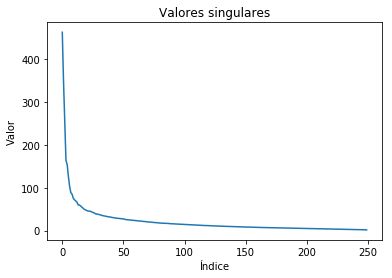

In [39]:
import matplotlib.pyplot as plt

U, s, Vh = np.linalg.svd(Z_norm)

print(U.shape)
plt.plot(s)
plt.title("Valores singulares")
plt.ylabel("Valor")
plt.xlabel("Índice")
np.allclose(Z , (U[:, :len(s)] @ np.diag(s) @ Vh))

Corto en la dimensión 25, parece guardar bastante información hasta ahí

In [40]:
from sklearn.manifold import TSNE

U_trunc = U[:, :20]

tsne = TSNE(2)

U_tsne = tsne.fit_transform(U_trunc)

In [41]:
import plotly.graph_objects as go

print(U.shape[0] == len(indexes))
fig = go.Figure(data=go.Scatter(
    x=U_tsne[:, 0], 
    y=U_tsne[:, 1],
    text=indexes,
    mode='markers',
    marker=dict(
        size=16,
        color=[hateful_score[tok] for tok in indexes], #set color equal to a variable
        colorscale='Magma', # one of plotly colorscales
        showscale=True)
))


fig.update_layout(
    autosize=False,
    width=1200,
    height=1200,
)

fig.show()

True


In [42]:
from sklearn.cluster.bicluster import SpectralBiclustering

num_clusters = 25
biclustering_range = list(range(3, 1+num_clusters))
biclustering = {}

for j in tqdm_notebook(biclustering_range):
    cluster = SpectralBiclustering(j)

    cluster.fit(Z_norm)
    
    biclustering[j] = cluster

In [43]:
from sklearn.metrics import consensus_score

consensus = []
zipped = list(zip(biclustering_range, biclustering_range[1:]))
for i, j in tqdm_notebook(zipped):
    bicluster1 = biclustering[i]
    bicluster2 = biclustering[j]
    consensus.append(consensus_score(bicluster1.biclusters_, bicluster2.biclusters_))

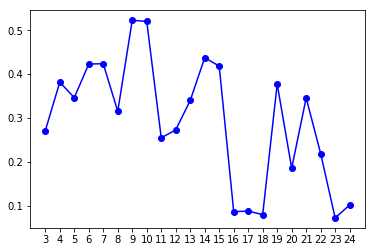

In [44]:
plt.plot(biclustering_range[:len(consensus)], consensus, "bo-")
plt.xticks(biclustering_range[:len(consensus)]);

In [45]:
bicluster = biclustering[11]

In [46]:
for i in range(bicluster.column_labels_.max()+1):
    print("="*80)
    print("="*80)
    print("Cluster número {}".format(i))
    
    neuronas = np.argwhere(bicluster.column_labels_ == i).reshape(-1)
    palabras = indexes[bicluster.row_labels_ == i]
    
    print("Hateful score promedio {:.3f}".format(hateful_score[palabras].mean()))
    
    print("{} neuronas: {}\n ".format(neuronas.shape[0], neuronas))
    print("Palabras ({})".format(palabras.shape[0]))
    print(" -- ".join(palabras))
    print("\nPalabras con más odio")
    
    palabras_mas_odiosas = hateful_score[palabras].sort_values(ascending=False)[:30].index
    print(" -- ".join(palabras_mas_odiosas))

Cluster número 0
Hateful score promedio 0.409
31 neuronas: [  8  15  35  45  49  53  65  69  70  74  81  82  88  91  92 117 118 131
 137 140 142 145 147 171 185 188 196 199 224 229 244]
 
Palabras (328)
abre -- acusan -- agentes -- agreden -- agresiones -- agua -- ahre -- aire -- alarma -- algeciras -- amplia -- anda -- andan -- apoya -- arrastrado -- aseguran -- asesinatos -- asesino -- atacan -- autobus -- autoridades -- ayudas -- baja -- beber -- blanco -- busca -- buscan -- busco -- caca -- caen -- cago -- call -- camion -- cancha -- capitan -- carne -- casa -- casas -- casos -- celos -- centros -- cerca -- ceuta -- chingar -- cierra -- ciudadania -- civil -- colau -- come -- comes -- condena -- considera -- consigue -- contra -- contribuye -- copa -- corre -- corrupto -- corta -- costas -- crimenes -- cruzar -- cuela -- cuentas -- cuesta -- culiao -- cultural -- daria -- debe -- deben -- dedos -- dejaron -- delincuencia -- delincuente -- delitos -- denunciando -- denuncias -- dere

In [48]:
import json
import os

filename = "heatmap-L1-0.002.json"


try:
    os.remove(filename)
except FileNotFoundError:
    pass

with open(filename, "w+") as f:
    f.write(fig_heatmap.to_json())

In [49]:
import json
import os

filename = "scatter-L1-0.002.json"


try:
    os.remove(filename)
except FileNotFoundError:
    pass

with open(filename, "w+") as f:
    f.write(fig.to_json())